<a href="https://colab.research.google.com/github/Fahim00727/Bank-Customer-Churn-Prediction/blob/main/Bank_Customer_Churn_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/content/Bank Customer Churn Prediction.csv')

In [ ]:
df.shape

(10000, 12)

In [ ]:
df.dtypes

customer_id           int64
credit_score          int64
country              object
gender               object
age                   int64
tenure                int64
balance             float64
products_number       int64
credit_card           int64
active_member         int64
estimated_salary    float64
churn                 int64
dtype: object

In [ ]:
df.head(10)

,customer_id,credit_score,country,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn
0,15634602,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,15647311,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,15619304,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,15701354,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,15737888,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0
5,15574012,645,Spain,Male,44,8,113755.78,2,1,0,149756.71,1
6,15592531,822,France,Male,50,7,0.00,2,1,1,10062.80,0
7,15656148,376,Germany,Female,29,4,115046.74,4,1,0,119346.88,1
8,15792365,501,France,Male,44,4,142051.07,2,0,1,74940.50,0
9,15592389,684,France,Male,27,2,134603.88,1,1,1,71725.73,0


In [ ]:
import numpy as np
from sklearn.preprocessing import LabelEncoder

def preprocess_data(df):
  pre_df = df.copy()

  pre_df["gender"] = pre_df["gender"].apply(lambda x: 0 if x=="Male" else 1)#for changing object type data
  pre_df = pre_df.drop(["customer_id"], axis=1)#for drop a column

  le = LabelEncoder()
  le.fit(pre_df['country'])
  pre_df['country'] = le.transform(pre_df['country'])


  return pre_df

In [ ]:
pre_df = preprocess_data(df)
pre_df.head(10)

,credit_score,country,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn
0,619,0,1,42,2,0.00,1,1,1,101348.88,1
1,608,2,1,41,1,83807.86,1,0,1,112542.58,0
2,502,0,1,42,8,159660.80,3,1,0,113931.57,1
3,699,0,1,39,1,0.00,2,0,0,93826.63,0
4,850,2,1,43,2,125510.82,1,1,1,79084.10,0
5,645,2,0,44,8,113755.78,2,1,0,149756.71,1
6,822,0,0,50,7,0.00,2,1,1,10062.80,0
7,376,1,1,29,4,115046.74,4,1,0,119346.88,1
8,501,0,0,44,4,142051.07,2,0,1,74940.50,0
9,684,0,0,27,2,134603.88,1,1,1,71725.73,0


In [ ]:
pre_df.isnull().any()

credit_score        False
country             False
gender              False
age                 False
tenure              False
balance             False
products_number     False
credit_card         False
active_member       False
estimated_salary    False
churn               False
dtype: bool

Draw a histogram on using of balance for country

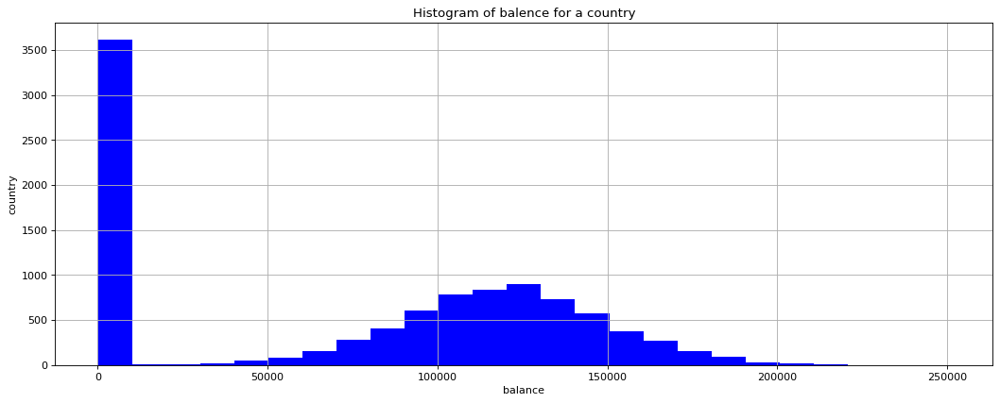

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.ticker import PercentFormatter

figure(figsize=(16, 6), dpi=80)



plt.hist(pre_df['balance'], 25, facecolor='b')

plt.xlabel('balance')
plt.ylabel('country')
plt.title('Histogram of balence for a country')
plt.grid(True)
plt.show()

2D Scatter plotting of balance against country

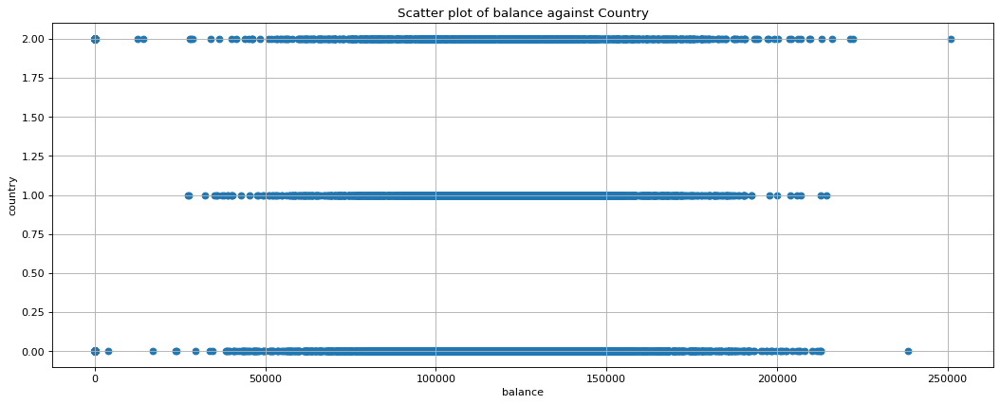

In [ ]:
figure(figsize=(16, 6), dpi=80)
plt.scatter(pre_df['balance'], pre_df['country'])
plt.xlabel('balance')
plt.ylabel('country')
plt.title('Scatter plot of balance against Country')
plt.grid(True)
plt.show()

For plotly we have to import this

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

3D scatter plotting

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode
configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

x, y, z = pre_df['credit_score'], pre_df['balance'], pre_df['estimated_salary']

fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
    mode='markers', marker=dict(
        size=4,
        color = pre_df['churn'].astype(int),
        opacity=0.8
    ),

    )])
fig.update_layout(scene = dict(
                    xaxis_title='credit_score',
                    yaxis_title='balance',
                    zaxis_title='estimated_salary'),margin=dict(l=0, r=0, b=0, t=0))
fig.show()

Histogram slider for all the columns against Churn column

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)

from plotly.offline import plot, iplot


import warnings
warnings.filterwarnings('ignore')

SEED = 17
pd.set_option('display.max_columns', None)

colors = plotly.colors.DEFAULT_PLOTLY_COLORS
churn_dict = {0: "no churn", 1: "churn"}

churn = pre_df[pre_df["churn"] == 1]
no_churn = pre_df[pre_df["churn"] == 0]

def create_churn_trace(col, visible=False):
    return go.Histogram(
        x=churn[col],
        name='churn',
        marker = dict(color = colors[1]),
        visible=visible,
    )

def create_no_churn_trace(col, visible=False):
    return go.Histogram(
        x=no_churn[col],
        name='no churn',
        marker = dict(color = colors[0]),
        visible = visible,
    )

features_not_for_hist = ["churn"]
features_for_hist = [x for x in pre_df.columns if x not in features_not_for_hist]
active_idx = 0
traces_churn = [(create_churn_trace(col) if i != active_idx else create_churn_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
traces_no_churn = [(create_no_churn_trace(col) if i != active_idx else create_no_churn_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
data = traces_churn + traces_no_churn

n_features = len(features_for_hist)
steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_hist[i],
    )
    step['args'][1][i] = True
    step['args'][1][i + n_features] = True
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 50},
    steps = steps,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='#samples',
        automargin=True,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='histogram_slider')

Boxplot slider for all the columns against outcome column

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)

from plotly.offline import plot, iplot


import warnings
warnings.filterwarnings('ignore')

SEED = 17
pd.set_option('display.max_columns', None)

colors = plotly.colors.DEFAULT_PLOTLY_COLORS
churn_dict = {0: "no churn", 1: "churn"}

churn = pre_df[pre_df["churn"] == 1]
no_churn = pre_df[pre_df["churn"] == 0]

def create_churn_trace(col, visible=False):
    return go.Box(
        x=churn[col],
        name='churn',
        marker = dict(color = colors[1]),
        visible=visible,
    )

def create_no_churn_trace(col, visible=False):
    return go.Box(
        x=no_churn[col],
        name='no churn',
        marker = dict(color = colors[0]),
        visible = visible,
    )

features_not_for_boxplot = ["churn"]
features_for_boxplot = ["credit_score","country","gender","age","tenure","balance","products_number","credit_card","active_member","estimated_salary"]
active_idx = 0
traces_churn = [(create_churn_trace(col) if i != active_idx else create_churn_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
traces_no_churn = [(create_no_churn_trace(col) if i != active_idx else create_no_churn_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
data = traces_churn + traces_no_churn

n_features = len(features_for_hist)
steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_boxplot[i],
    )
    step['args'][1][i] = True
    step['args'][1][i + n_features] = True
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 50},
    steps = steps,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='#samples',
        automargin=True,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='Boxplot_slider')

Min-Max normalization

In [ ]:
df['estimated_salary'].describe()

count     10000.000000
mean     100090.239881
std       57510.492818
min          11.580000
25%       51002.110000
50%      100193.915000
75%      149388.247500
max      199992.480000
Name: estimated_salary, dtype: float64

In [ ]:
normalized_df = df

normalized_df['estimated_salary']=(df['estimated_salary']-df['estimated_salary'].min())/(df['estimated_salary'].max()-df['estimated_salary'].min())

In [ ]:
normalized_df['estimated_salary'].describe()

count    10000.000000
mean         0.500441
std          0.287580
min          0.000000
25%          0.254977
50%          0.500960
75%          0.746955
max          1.000000
Name: estimated_salary, dtype: float64

Outlier Dtection

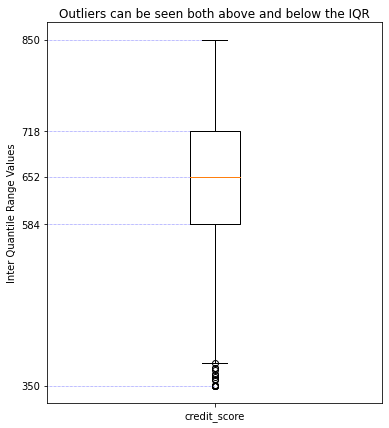

In [ ]:
#for credit score column
import numpy as np
import matplotlib.pylab as plt


fig = plt.figure(1, figsize=(6, 7))
ax = fig.add_subplot(111)

ax.set_title('Outliers can be seen both above and below the IQR')

ax.boxplot(pre_df['credit_score'], vert=True, manage_ticks=True)
ax.set_ylabel('Inter Quantile Range Values')
#ax.set_yticklabels(['Min','Q1','Median', 'Q3','Max'])
ax.set_xticklabels(['credit_score'])

quantiles = np.quantile(pre_df['credit_score'], np.array([0.00, 0.25, 0.50, 0.75, 1.00]))
ax.hlines(quantiles, [0] * quantiles.size, [1] * quantiles.size,
          color='b', ls=':', lw=0.5, zorder=0)
ax.set_xlim(0.5, 1.5)
ax.set_yticks(quantiles)
plt.show()

Above we are boxplotting for the all the columns using pyplot where we can see that we have outlier in the creditscore and the in the age column now we have to handle those outliers using Bining

In [ ]:
pre_df.describe()

,credit_score,country,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,650.528800,0.746300,0.454300,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,96.653299,0.827529,0.497932,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,350.000000,0.000000,0.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,584.000000,0.000000,0.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,652.000000,0.000000,0.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,718.000000,1.000000,1.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,850.000000,2.000000,1.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


In [ ]:

pre_df['credit_score'].min()

350

In [ ]:
pre_df['credit_score'].max()

850

In [ ]:
median=pre_df.loc[pre_df['credit_score']>350,'credit_score'].median()

In [ ]:
pre_df.loc[pre_df['credit_score']<400,'credit_score']=np.nan

In [ ]:
pre_df['credit_score'].fillna(median,inplace=True)

(9526, 11)


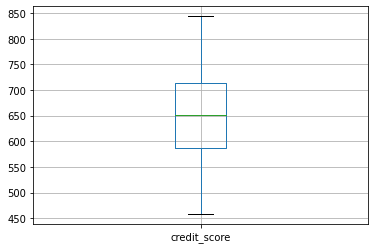

In [ ]:
pre_df=pre_df[np.abs(pre_df['credit_score']-pre_df['credit_score'].mean())<=(2*df['credit_score'].std())]
pre_df.boxplot(column='credit_score')
print(pre_df.shape)

Draw a heatmap

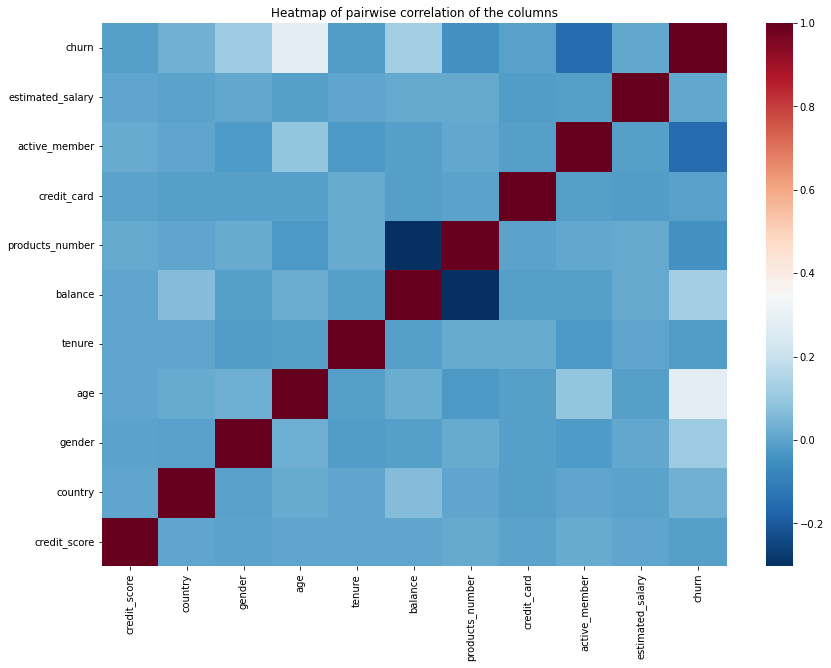

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

f, ax = plt.subplots(figsize=(14, 10))

corr = pre_df.corr()

ax = sns.heatmap(corr, cmap = "RdBu_r")

ax.invert_yaxis()

plt.title("Heatmap of pairwise correlation of the columns")

plt.show()

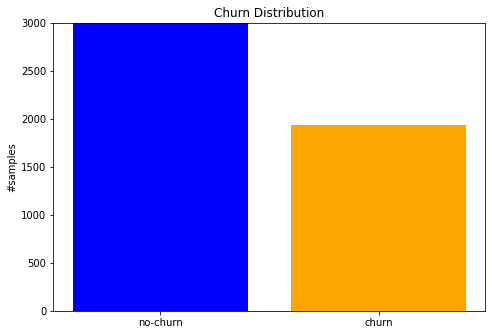

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
target = ['no-churn', 'churn']
hists = [len(pre_df[pre_df["churn"] == 0]),len(pre_df[pre_df["churn"] == 1])]
ax.bar(target,hists, color=['blue','orange'],)
plt.title("Churn Distribution")
plt.ylabel('#samples')
plt.ylim(0,3000)
plt.show()
plt.savefig("hist.jpg")

Check how many will churn

In [ ]:
churn_perc = pre_df["churn"].sum() * 100 / pre_df["churn"].shape[0]
print("Churn percentage is %.3f%%." % churn_perc)

Churn percentage is 20.355%.


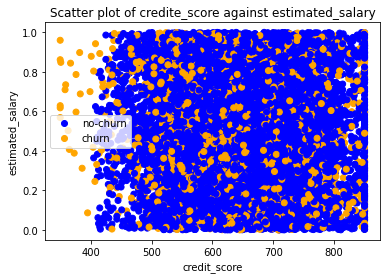

In [ ]:
import matplotlib
# figure(figsize=(10, 8), dpi=80)

label = [0,1]
colors = ['blue','orange']

scatter = plt.scatter(df['credit_score'], df['estimated_salary'], c=df['churn'], cmap=matplotlib.colors.ListedColormap(colors))
plt.xlabel('credit_score')
plt.ylabel('estimated_salary')
plt.title('Scatter plot of credite_score against estimated_salary')
plt.legend(handles=scatter.legend_elements()[0],
           labels=target)
# plt.grid(True)
plt.show()

Confidence Interval Estimate

In [ ]:
import numpy as np
import scipy.stats as st

st.t.interval(alpha=0.90, df=len(pre_df['country'])-1, loc=np.mean(pre_df['country']), scale=st.sem(pre_df['country']))

(0.7342003404497749, 0.7621255046058623)

We are  90%  confident that the population mean number of countries  falls between 0.73 and 0.76.

In [ ]:
st.t.interval(alpha=0.90, df=len(pre_df['credit_score'])-1, loc=np.mean(pre_df['credit_score']), scale=st.sem(pre_df['credit_score']))

(648.8914089507949, 651.8157084122116)

We are 90% confident that the population mean number of credit_score falls between 648.94 and 652.17.

In [ ]:
france = pre_df[pre_df["country"]=="Germany"]

In [ ]:
france['estimated_salary'].describe()

count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: estimated_salary, dtype: float64

In [ ]:
st.t.interval(alpha=0.95, df=len(france['credit_score'])-1, loc=np.mean(france['credit_score']), scale=st.sem(france['credit_score']))

(nan, nan)

Regression line

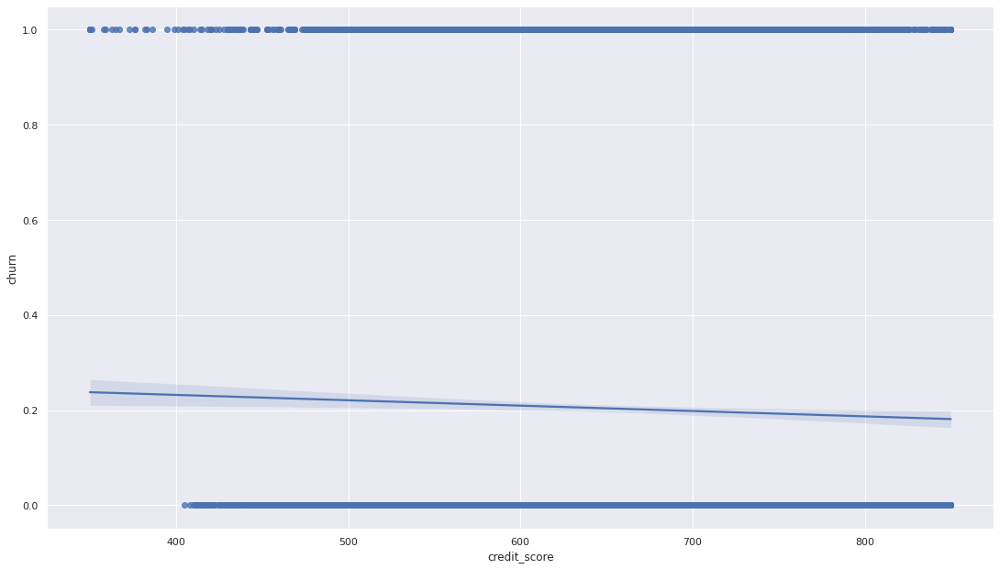

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(color_codes=True)
fig, ax = plt.subplots()
fig.set_size_inches(18.5, 10.5)
sns.regplot(x="credit_score", y="churn", data=df, ax=ax)

Regression equation for credit score against churn column

In [ ]:
def regression_equation(x, y):
    x_mean = x.mean()
    y_mean = y.mean()
    x_squared = (x**2).sum()
    xy = (x*y).sum()
    std_dev = x.std()
    var_x = std_dev ** 2
    cov_xy = (xy - len(x)*x_mean*y_mean)/(len(x)-1)
    b_1 = cov_xy/var_x
    b_0 = y_mean - b_1*x_mean
    print('Regression equation is: %.3f %.3f (x)' % (b_0, b_1))
    y_hat = b_0+b_1*x
    return y_hat

In [ ]:
pred = regression_equation(df['credit_score'], df['churn'])
print(pred)

Regression equation is: 0.277 -0.000 (x)
0       0.207260
1       0.208502
2       0.220469
3       0.198227
4       0.181179
          ...   
9995    0.190098
9996    0.218889
9997    0.197098
9998    0.189986
9999    0.187728
Name: credit_score, Length: 10000, dtype: float64


Residuals

In [ ]:
pred_rating = pd.DataFrame()

pred_rating['bank_churn'] = df['credit_score']
pred_rating['Actual Rating']  = df['churn']
pred_rating['Predicted Rating'] =  pred
pred_rating['Predicted Error'] = df['churn'] - pred

In [ ]:
pred_rating.head(5)

,bank_churn,Actual Rating,Predicted Rating,Predicted Error
0,619,1,0.207260,0.792740
1,608,0,0.208502,-0.208502
2,502,1,0.220469,0.779531
3,699,0,0.198227,-0.198227
4,850,0,0.181179,-0.181179


In [ ]:
pred_rating['Absolute Error']=abs(pred_rating['Predicted Error'])

In [ ]:
pred_rating['Absolute Error'].sum()

3241.744817057599

In [ ]:
pred_rating['Absolute Error'].mean()

0.3241744817057599

In [ ]:
import math
avarage = pred_rating['Predicted Error'].mean()
print(avarage)

3.232969447708456e-17


New regression

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook


layout = dict(
    yaxis=dict(
        title='churn',
        automargin=True,
    ),
    xaxis=dict(
        title='Feature: credit_score',
        automargin=True,
    ),
)
fig = go.Figure(layout=layout)

# Add traces
fig.add_trace(go.Scatter(x=df['credit_score'], y=df['churn'],
                    mode='markers',
                    name='churn'))
fig.add_trace(go.Scatter(x=df['credit_score'], y=(0.277 -0.000*df['credit_score']),
                    mode='lines',
                    name='Regression'))


fig.show()

Regression slider

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

from plotly.offline import plot, iplot

# do not show any warnings
import warnings
warnings.filterwarnings('ignore')

SEED = 17 # specify seed for reproducable results
pd.set_option('display.max_columns', None) # prevents abbreviation (with '...') of columns in prints

colors = plotly.colors.DEFAULT_PLOTLY_COLORS

def create_scatter_trace(x, y, visible=False):
    return go.Scatter(x=df[x], y=df[y],
                    mode='markers',
                    name=y.title(),
                    marker = dict(
                        size=8,
                    ),
                    visible=visible)

def create_line_trace(x,y, visible=False):
    return go.Scatter(x=df[x], y=regression_equation(df[x],df[y]),
                    mode='lines',
                    name='Regression',
                    visible=visible)

features_not_for_reg = ["credit_card", "active_member", "country", "gender", "churn"]
features_for_reg = [x for x in df.columns if x not in features_not_for_reg]
active_idx = 0

traces_scatter = [(create_scatter_trace(col,'churn') if i != active_idx else create_scatter_trace(col,'churn', visible=True)) for i, col in enumerate(features_for_reg)]
traces_line = [(create_line_trace(col,'churn') if i != active_idx else create_line_trace(col,'churn', visible=True)) for i, col in enumerate(features_for_reg)]

data = traces_scatter + traces_line

n_features = len(features_for_reg)

steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_reg[i],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    step['args'][1][i + n_features] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 50},
    steps = steps,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='churn',
        automargin=True,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='regression_slider')

Regression equation is: 0.753 -0.000 (x)
Regression equation is: 0.277 -0.000 (x)
Regression equation is: -0.223 0.011 (x)
Regression equation is: 0.213 -0.002 (x)
Regression equation is: 0.145 0.000 (x)
Regression equation is: 0.254 -0.033 (x)
Regression equation is: 0.195 0.017 (x)


corelation coefficient

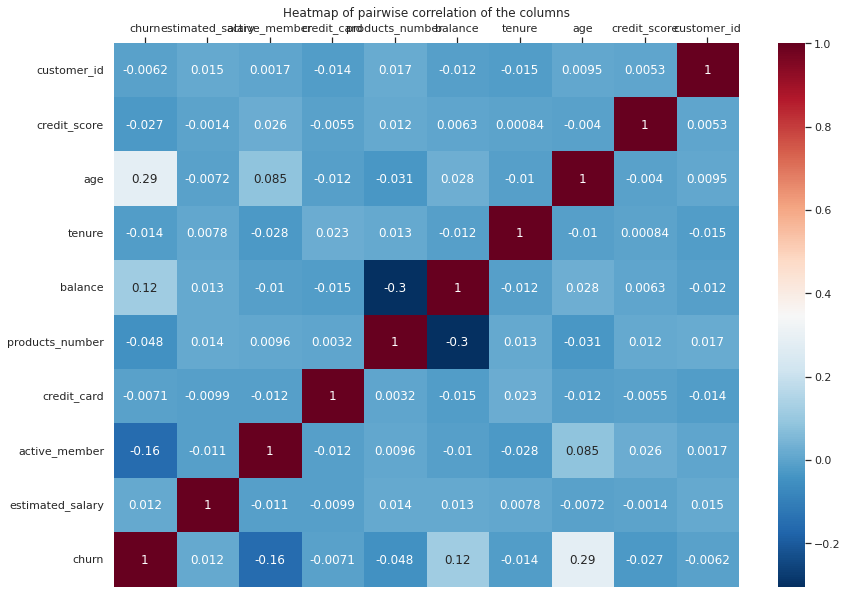

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

f, ax = plt.subplots(figsize=(14, 10))

corr = df.corr()

ax = sns.heatmap(corr, cmap = "RdBu_r", annot=True)#annot hochche annotation true rakhle value dekhabe false rakhle value dekhabe na

ax.invert_xaxis()

ax.xaxis.set_ticks_position('top')

plt.title("Heatmap of pairwise correlation of the columns")

plt.show()

# KNN model


In [ ]:
print(type(df))
import numpy as np
data = np.asarray(df)

<class 'pandas.core.frame.DataFrame'>


In [ ]:
data

array([[15634602, 619, 'France', ..., 1, 0.5067348931822989, 1],
       [15647311, 608, 'Spain', ..., 1, 0.5627087386845443, 0],
       [15619304, 502, 'France', ..., 0, 0.5696543519906151, 1],
       ...,
       [15584532, 709, 'France', ..., 1, 0.21039009225381022, 1],
       [15682355, 772, 'Germany', ..., 0, 0.46442905297455905, 1],
       [15628319, 792, 'France', ..., 0, 0.1909142323091855, 0]],
      dtype=object)

In [ ]:
data_X=data[:,:-1]
data_y=data[:,-1]

In [ ]:
data_X.shape

(10000, 11)

In [ ]:
data_y.shape

(10000,)

In [ ]:
print(data_y.shape)
data_y=np.asarray([0 if i == 'A' else 1 if i == 'B' else 2 for i in data_y])

(10000,)


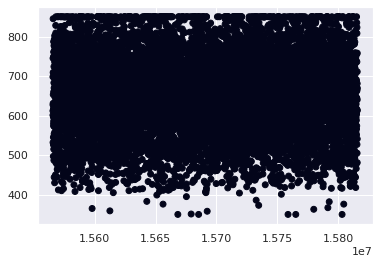

In [ ]:
import matplotlib.pyplot as plt
plt.scatter(data_X[:,0],data_X[:,1],data_y*15+5,data_y*15+5)

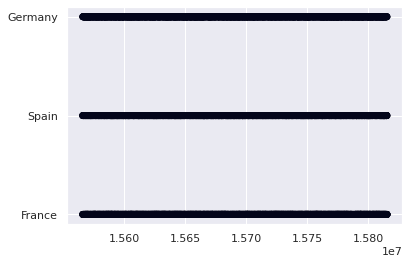

In [ ]:
plt.scatter(data_X[:,0],data_X[:,2],data_y*15+5,data_y*15+5)

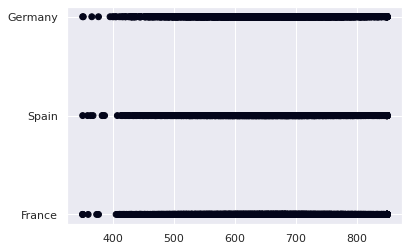

In [ ]:
plt.scatter(data_X[:,1],data_X[:,2],data_y*15+5,data_y*15+5)

In [ ]:
from numpy import *
import operator
def classifyKNN(test_x,X,y,k):
  # change the y label to vector
  y=np.reshape(y,(y.shape[0],)) #reshaping the y labels (optional)

  dataSetSize = X.shape[0] #length of the training instances
  diffMat = np.tile(test_x, (dataSetSize,1)) #copies test instance for training instances size
  diffMat = diffMat - X
  sqDiffMat = diffMat**2
  sqDistances = sqDiffMat.sum(axis=1)
  distances = sqDistances**0.5
  sortedDistIndicies = distances.argsort()#distance er value gulo sort korbo
  #print(sortedDistIndicies)
  classCount={}
  for i in range(k):#0-2 porjonto loop hobe
    voteIlabel = y[sortedDistIndicies[i]] #sort er sobcheye choto value er y er value identify kore votelabel e rakhchi
    classCount[voteIlabel] = classCount.get(voteIlabel,0) + 1 #0 no index of the dictionary jokhon vote count pachi tokhon class count barabo
  sortedClassCount = sorted(classCount.items(), key=operator.itemgetter(1), reverse=True)
  return sortedClassCount[0][0]

## K Nearest Neighbours

### Import Dataset

In [ ]:
knn_model_df = pre_df.copy()

In [ ]:
knn_model_df.dtypes

customer_id           int64
credit_score          int64
country               int64
gender               object
age                   int64
tenure                int64
balance             float64
products_number       int64
credit_card           int64
active_member         int64
estimated_salary    float64
churn                 int64
dtype: object

In [ ]:
le = LabelEncoder()
le.fit(knn_model_df['gender'])
knn_model_df['gender'] = le.transform(knn_model_df['gender'])

### Train Test split

In [ ]:
X = knn_model_df.iloc[:,:-1].copy()
X.head()

,customer_id,credit_score,country,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary
0,15634602,619,0,0,42,2,0.00,1,1,1,101348.88
1,15647311,608,2,0,41,1,83807.86,1,0,1,112542.58
2,15619304,502,0,0,42,8,159660.80,3,1,0,113931.57
3,15701354,699,0,0,39,1,0.00,2,0,0,93826.63
4,15737888,850,2,0,43,2,125510.82,1,1,1,79084.10


In [ ]:
y = knn_model_df.iloc[:,-1].copy()
y.head()

0    1
1    0
2    1
3    0
4    0
Name: churn, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(7000, 11) (3000, 11) (7000,) (3000,)


### Apply Knn Model

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
model = KNeighborsClassifier(n_neighbors = 5)

In [ ]:
model.fit(X_train, y_train)
prediction = model.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score
result = accuracy_score(y_test, prediction)
result

0.7616666666666667

In [ ]:
from sklearn.metrics import confusion_matrix
con_mat = confusion_matrix(y_test, prediction)
print(con_mat)

[[2227  146]
 [ 569   58]]


In [ ]:
newMat = pd.DataFrame(data=con_mat, index = ['Churn','No Churn'], columns = ['Churn','No Churn'])
newMat.transpose()

,Churn,No Churn
Churn,2227,569
No Churn,146,58


In [ ]:
comparisonTable = pd.DataFrame(data = [y_test.values,prediction], index = ['Actual','Prediction'])
comparisonTable.transpose()

,Actual,Prediction
0,0,0
1,0,0
2,0,0
3,0,0
4,0,0
...,...,...
2995,0,0
2996,0,0
2997,0,0
2998,0,0


# Using CLASSIFICATION REGRESSION TREE

In [ ]:
from sklearn.tree import DecisionTreeClassifier

clf_gini = DecisionTreeClassifier(criterion='gini',max_depth=3, random_state=42)
clf_gini.fit(X_train, y_train)
y_pred_gini = clf_gini.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score

score = accuracy_score(y_pred_gini, y_test)
print(score)

0.8476666666666667


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       0.85      0.99      0.91      2416
           1       0.87      0.26      0.40       584

    accuracy                           0.85      3000
   macro avg       0.86      0.62      0.65      3000
weighted avg       0.85      0.85      0.81      3000



[Text(0.5, 0.875, 'X[4] <= 24.5\ngini = 0.329\nsamples = 7000\nvalue = [5547, 1453]'),
 Text(0.25, 0.625, 'X[7] <= 1.5\ngini = 0.213\nsamples = 4981\nvalue = [4379, 602]'),
 Text(0.125, 0.375, 'X[7] <= 0.5\ngini = 0.19\nsamples = 4869\nvalue = [4350, 519]'),
 Text(0.0625, 0.125, 'gini = 0.279\nsamples = 2431\nvalue = [2023, 408]'),
 Text(0.1875, 0.125, 'gini = 0.087\nsamples = 2438\nvalue = [2327, 111]'),
 Text(0.375, 0.375, 'X[6] <= 29.5\ngini = 0.384\nsamples = 112\nvalue = [29, 83]'),
 Text(0.3125, 0.125, 'gini = 0.499\nsamples = 40\nvalue = [21, 19]'),
 Text(0.4375, 0.125, 'gini = 0.198\nsamples = 72\nvalue = [8, 64]'),
 Text(0.75, 0.625, 'X[9] <= 0.5\ngini = 0.488\nsamples = 2019\nvalue = [1168, 851]'),
 Text(0.625, 0.375, 'X[4] <= 32.5\ngini = 0.473\nsamples = 889\nvalue = [341, 548]'),
 Text(0.5625, 0.125, 'gini = 0.5\nsamples = 586\nvalue = [298, 288]'),
 Text(0.6875, 0.125, 'gini = 0.244\nsamples = 303\nvalue = [43, 260]'),
 Text(0.875, 0.375, 'X[7] <= 1.5\ngini = 0.392\nsampl

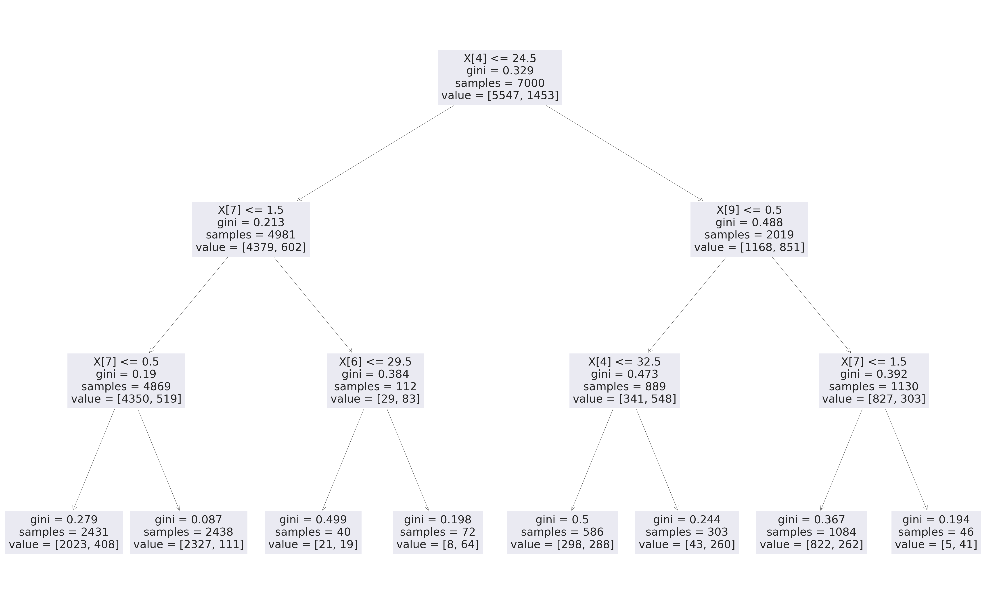

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(80,50))

from sklearn import tree
tree.plot_tree(clf_gini.fit(X_train, y_train))

K-Mean Clustering

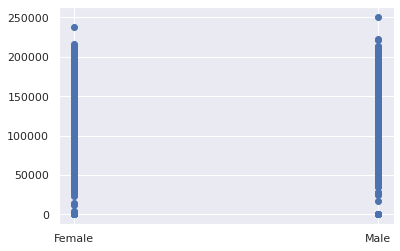

In [ ]:
import matplotlib.pyplot as plt
plt.scatter(df['gender'], df['balance'])

In [ ]:
from sklearn.cluster import KMeans
kmeanModel = KMeans(n_clusters = 5)
result = kmeanModel.fit_predict(pre_df[['estimated_salary', 'gender', 'balance']])
result

array([0, 4, 4, ..., 2, 4, 1], dtype=int32)

In [ ]:
pre_df['Output Group'] = result
pre_df.head()

,credit_score,country,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn,Output Group
0,619.0,0,1,42,2,0.00,1,1,1,101348.88,1,0
1,608.0,2,1,41,1,83807.86,1,0,1,112542.58,0,4
2,502.0,0,1,42,8,159660.80,3,1,0,113931.57,1,4
3,699.0,0,1,39,1,0.00,2,0,0,93826.63,0,2
5,645.0,2,0,44,8,113755.78,2,1,0,149756.71,1,3


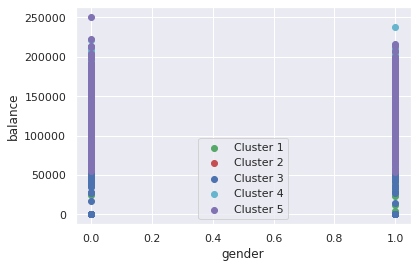

In [ ]:
cluster1 = pre_df[pre_df['Output Group'] == 0]
cluster2 = pre_df[pre_df['Output Group'] == 1]
cluster3 = pre_df[pre_df['Output Group'] == 2]
cluster4 = pre_df[pre_df['Output Group'] == 3]
cluster5 = pre_df[pre_df['Output Group'] == 4]
plt.scatter(cluster1['gender'], cluster1['balance'], color = 'g', label = 'Cluster 1')
plt.scatter(cluster2['gender'], cluster2['balance'], color = 'r', label = 'Cluster 2')
plt.scatter(cluster3['gender'], cluster3['balance'], color = 'b', label = 'Cluster 3')
plt.scatter(cluster4['gender'], cluster4['balance'], color = 'c', label = 'Cluster 4')
plt.scatter(cluster5['gender'], cluster5['balance'], color = 'm', label = 'Cluster 5')

#plt.scatter(kmeanModel.cluster_centers_[:,0], kmeanModel.cluster_centers_[:,1], color = 'b', marker = '*', label = 'centroids')
plt.xlabel('gender')
plt.ylabel('balance')
plt.legend()

In [ ]:
kmeanModel.cluster_centers_

array([[1.49485103e+05, 4.69399214e-01, 2.36772852e+03],
       [3.45068229e+04, 4.46130501e-01, 1.22389708e+05],
       [5.04168247e+04, 4.46145435e-01, 2.07605049e+03],
       [1.67319880e+05, 4.57025219e-01, 1.22522024e+05],
       [1.01099530e+05, 4.52905812e-01, 1.20437205e+05]])

Elbow Plot

In [ ]:
sse = []
k_rng = range(1,10)
for k in k_rng:
    model = KMeans(n_clusters = k)
    model.fit(pre_df[['gender','balance']])
    sse.append(model.inertia_)

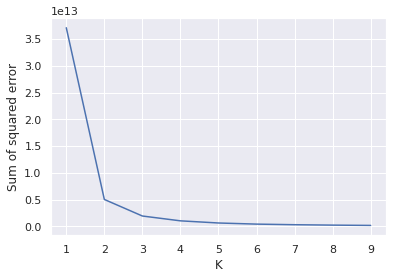

In [ ]:
plt.xlabel('K')
plt.ylabel('Sum of squared error')
plt.plot(k_rng,sse)

Hierarchical Clustering

In [ ]:
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

In [ ]:
hrModel = AgglomerativeClustering(n_clusters = 5,affinity = 'euclidean',linkage = 'ward')
result = hrModel.fit_predict(pre_df)

In [ ]:
hdf=pre_df.copy()

In [ ]:
hdf['Output Group'] = result

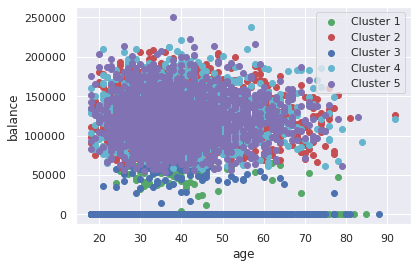

In [ ]:
cluster1 = pre_df[pre_df['Output Group'] == 0]
cluster2 = pre_df[pre_df['Output Group'] == 1]
cluster3 = pre_df[pre_df['Output Group'] == 2]
cluster4 = pre_df[pre_df['Output Group'] == 3]
cluster5 = pre_df[pre_df['Output Group'] == 4]
plt.scatter(cluster1['age'], cluster1['balance'], color = 'g', label = 'Cluster 1')
plt.scatter(cluster2['age'], cluster2['balance'], color = 'r', label = 'Cluster 2')
plt.scatter(cluster3['age'], cluster3['balance'], color = 'b', label = 'Cluster 3')
plt.scatter(cluster4['age'], cluster4['balance'], color = 'c', label = 'Cluster 4')
plt.scatter(cluster5['age'], cluster5['balance'], color = 'm', label = 'Cluster 5')

plt.xlabel('age')
plt.ylabel('balance')
plt.legend()

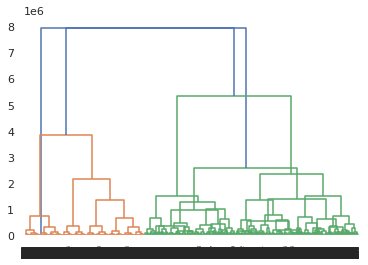

In [ ]:
dendo = sch.dendrogram(sch.linkage(pre_df[['age','balance']], method='ward'))
dendo = sch.dendrogram(sch.linkage(pre_df, method='ward'))